In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import os
from datetime import datetime
import pandas as pd
import plotly.express as px
import sys, os
sys.path.append(os.path.abspath(os.path.join('../scripts')))
from read_write_util import ReadWriteUtil

mpl.rcParams['figure.figsize'] = (10, 8)
mpl.rcParams['axes.grid'] = False


In [5]:
# reader = ReadWriteUtil()
# df_train = reader.dvc_get_data('../data/train.csv', 'v3merged')
# df_train

In [6]:
df = pd.read_csv('../data/train_merged_with_date.csv')
df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,...,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionBeforeStoreOpened,PromoInterval0,PromoInterval1,PromoInterval2,PromoInterval3
0,1,2,2013-01-01,0,0,0,0,a,1,2013,...,2008.0,0,0.0,0.0,"0,0,0,0",0,0,0,0,0
1,1,3,2013-01-02,5530,668,1,0,0,1,2013,...,2008.0,0,0.0,0.0,"0,0,0,0",0,0,0,0,0
2,1,4,2013-01-03,4327,578,1,0,0,1,2013,...,2008.0,0,0.0,0.0,"0,0,0,0",0,0,0,0,0
3,1,5,2013-01-04,4486,619,1,0,0,1,2013,...,2008.0,0,0.0,0.0,"0,0,0,0",0,0,0,0,0
4,1,6,2013-01-05,4997,635,1,0,0,1,2013,...,2008.0,0,0.0,0.0,"0,0,0,0",0,0,0,0,0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 28 columns):
 #   Column                        Non-Null Count    Dtype  
---  ------                        --------------    -----  
 0   Store                         1017209 non-null  int64  
 1   DayOfWeek                     1017209 non-null  int64  
 2   Date                          1017209 non-null  object 
 3   Sales                         1017209 non-null  int64  
 4   Customers                     1017209 non-null  int64  
 5   Open                          1017209 non-null  int64  
 6   Promo                         1017209 non-null  int64  
 7   StateHoliday                  1017209 non-null  object 
 8   SchoolHoliday                 1017209 non-null  int64  
 9   Year                          1017209 non-null  int64  
 10  Month                         1017209 non-null  int64  
 11  DayOfMonth                    1017209 non-null  int64  
 12  WeekOfYear                  

In [8]:
df['Date'] = pd.to_datetime(df['Date'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 28 columns):
 #   Column                        Non-Null Count    Dtype         
---  ------                        --------------    -----         
 0   Store                         1017209 non-null  int64         
 1   DayOfWeek                     1017209 non-null  int64         
 2   Date                          1017209 non-null  datetime64[ns]
 3   Sales                         1017209 non-null  int64         
 4   Customers                     1017209 non-null  int64         
 5   Open                          1017209 non-null  int64         
 6   Promo                         1017209 non-null  int64         
 7   StateHoliday                  1017209 non-null  object        
 8   SchoolHoliday                 1017209 non-null  int64         
 9   Year                          1017209 non-null  int64         
 10  Month                         1017209 non-null  int64         
 11

In [9]:
fig = px.line(df, x='Date', y='Sales', title='Sales')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=2, label="3y", step="year", stepmode="backward"),
            dict(count=3, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [23]:
sales_df = df.set_index('Date')[['Sales', 'Customers','Store']]

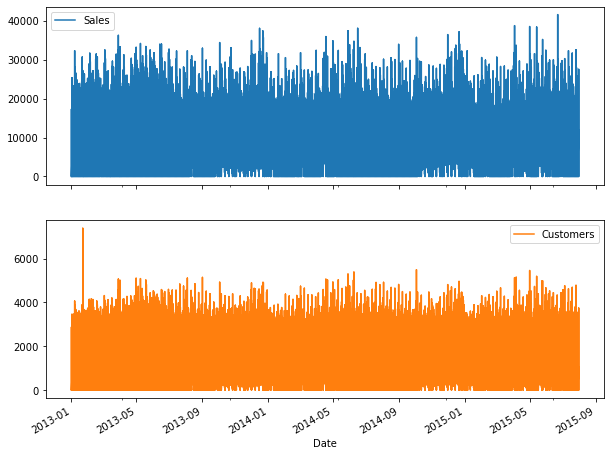

In [24]:
sales_df[['Sales', 'Customers']].plot(subplots=True);

In [26]:
grouped_sales = sales_df.groupby('Store')
grouped_sales.resample('D').mean()

Sales  Customers   Store
Store Date                                  
1     2013-01-01      0.0        0.0     1.0
      2013-01-02   5530.0      668.0     1.0
      2013-01-03   4327.0      578.0     1.0
      2013-01-04   4486.0      619.0     1.0
      2013-01-05   4997.0      635.0     1.0
...                   ...        ...     ...
1115  2015-07-27  10712.0      608.0  1115.0
      2015-07-28   8093.0      500.0  1115.0
      2015-07-29   7661.0      473.0  1115.0
      2015-07-30   8405.0      502.0  1115.0
      2015-07-31   8680.0      538.0  1115.0

[1050329 rows x 3 columns]

array([<AxesSubplot:xlabel='Store,Date'>,
       <AxesSubplot:xlabel='Store,Date'>], dtype=object)

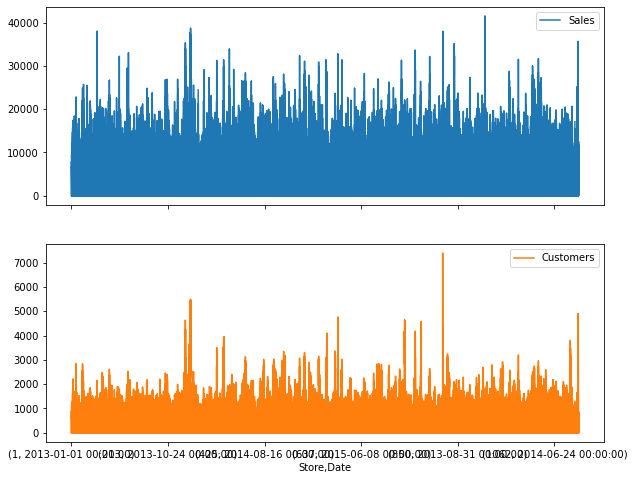

In [30]:
grouped_sales[['Sales', 'Customers']].resample('D').mean().plot(subplots=True)

In [34]:
df_daily=grouped_sales[['Sales', 'Customers']].resample('D').mean()

In [35]:
from prophet import Prophet

In [36]:
df_final=df_daily.reset_index()[['Date','Sales']].rename({'Date':'ds','Sales':'y'}, axis='columns')

In [37]:
df_final

,ds,y
0,2013-01-01,0.0
1,2013-01-02,5530.0
2,2013-01-03,4327.0
3,2013-01-04,4486.0
4,2013-01-05,4997.0
...,...,...
1050324,2015-07-27,10712.0
1050325,2015-07-28,8093.0
1050326,2015-07-29,7661.0
1050327,2015-07-30,8405.0


In [58]:
train=df_final[(df_final['ds'] >= '2013-01-01') & (df_final['ds'] <= '2015-02-27')]
test=df_final[(df_final['ds'] > '2015-02-27')]

In [59]:
train.shape

(878619, 2)

In [60]:
test.shape

(171710, 2)

In [69]:
m = Prophet(interval_width=0.95,yearly_seasonality=True,
        weekly_seasonality=False,
        daily_seasonality=False, mcmc_samples = 500)

m.add_seasonality(
    name='monthly', 
    period=30.5, 
    fourier_order=5
)

In [70]:
m.fit(train)

14:00:49 - cmdstanpy - INFO - CmdStan installation /home/n/anaconda3/lib/python3.9/site-packages/prophet/stan_model/cmdstan-2.26.1 missing makefile, cannot get version.
14:00:49 - cmdstanpy - INFO - Cannot determine whether version is before 2.28.
14:00:49 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

In [66]:
m.params

OrderedDict([('lp__', array([[1722150.]])),
             ('k', array([[0.125096]])),
             ('m', array([[0.132447]])),
             ('delta',
              array([[ 0.105635  , -0.017419  , -0.157522  ,  0.0179899 ,  0.0351084 ,
                      -0.0603202 , -0.101765  , -0.051529  ,  0.0405488 , -0.0205694 ,
                      -0.00488683, -0.0194125 ,  0.0830652 , -0.00609718,  0.0616782 ,
                       0.0916391 , -0.0209936 ,  0.169212  , -0.0860697 , -0.239337  ,
                      -0.022283  ,  0.0682255 ,  0.00369485, -0.0309919 , -0.0277895 ]])),
             ('sigma_obs', array([[0.0791159]])),
             ('beta',
              array([[-3.88177e-03,  1.21676e-02, -2.01497e-03,  6.39026e-03,
                      -6.85374e-03, -1.73196e-04, -4.77484e-03, -1.89274e-03,
                      -4.17098e-03, -2.84143e-03, -2.28165e-03, -4.50864e-03,
                      -1.55341e-03, -4.38801e-03, -1.70302e-03, -3.80870e-03,
                       5.218